# COURSE: A deep understanding of deep learning
## SECTION: Gradient descent
### LECTURE: Gradient descent in 2D
#### TEACHER: Mike X Cohen, sincxpress.com
##### COURSE URL: udemy.com/course/deeplearning_x/?couponCode=202305

In [2]:
# import all necessary modules
import numpy as np
import matplotlib.pyplot as plt
import sympy as sym # sympy to compute the partial derivatives

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

# Gradient descent in 2D

In [3]:
# the "peaks" function
def peaks(x: list, y: list):
  # expand to a 2D mesh
  x,y = np.meshgrid(x,y)
  
  z = 3*(1-x)**2 * np.exp(-(x**2) - (y+1)**2) \
      - 10*(x/5 - x**3 - y**5) * np.exp(-x**2-y**2) \
      - 1/3*np.exp(-(x+1)**2 - y**2)
  return z

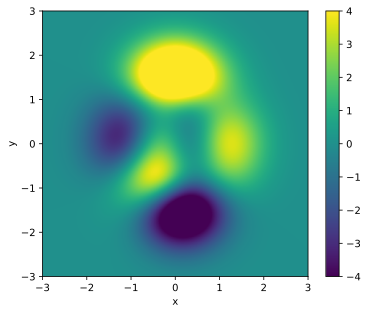

In [4]:
# create the landscape
x = np.linspace(-3,3,201)
y = np.linspace(-3,3,201)

# use labels for the axes
Z = peaks(x,y)
plt.xlabel('x')
plt.ylabel('y')
 

# let's have a look!
plt.imshow(Z,extent=[x[0],x[-1],y[0],y[-1]],vmin=-4,vmax=4,origin='lower')
plt.colorbar()
plt.show()

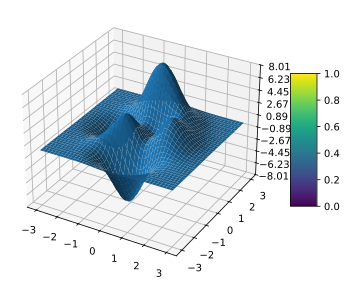

In [22]:
from matplotlib.ticker import LinearLocator

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
X, Y = np.meshgrid(x, y)
surf = ax.plot_surface(X, Y, Z, linewidth=0, antialiased=False)
# Customize the z axis.
ax.set_zlim(-8.01, 8.01)
ax.zaxis.set_major_locator(LinearLocator(10))
# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')
# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

In [5]:
# create derivative functions using sympy

sx,sy = sym.symbols('sx,sy')

sZ = 3*(1-sx)**2 * sym.exp(-(sx**2) - (sy+1)**2) \
      - 10*(sx/5 - sx**3 - sy**5) * sym.exp(-sx**2-sy**2) \
      - 1/3*sym.exp(-(sx+1)**2 - sy**2)


# create functions from the sympy-computed derivatives
df_x = sym.lambdify( (sx,sy),sym.diff(sZ,sx),'sympy' )
df_y = sym.lambdify( (sx,sy),sym.diff(sZ,sy),'sympy' )

df_x(1,1).evalf()

-1.07369833656079

In [19]:
# learning parameters
learning_rate = .01
training_epochs = 500

# run through training
trajectory = np.zeros((training_epochs+1,2))

sizem = 20
sizen = 20
# Montecarlo simulation
startpnts = np.zeros((sizem + 1, sizen + 1, 2))
localmins = np.zeros((sizem + 1, sizen + 1,2))
trajectories = np.zeros((sizem + 1, sizen + 1,training_epochs+1,2))


for m in range(sizem + 1):
    for n in range(sizen + 1):
        # random starting point (uniform between -2 and +2)
        localmin = [4*m/sizem-2, 4*n/sizen-2] # also try specifying coordinates
        
        startpnt = localmin[:] # make a copy, not re-assign
        startpnts[m,n,:] = startpnt
        trajectory[0,:] = startpnt
        
        for i in range(training_epochs):
            grad = np.array([ df_x(localmin[0],localmin[1]).evalf(), 
                                df_y(localmin[0],localmin[1]).evalf() 
                            ])
            localmin = localmin - learning_rate*grad  # add _ or [:] to change a variable in-place
            if (localmin[0] <= 4) and (localmin[0] >= -4) and (localmin[1] <= 4) and (localmin[1] >= -4):
                trajectory[i+1,:] = localmin
        
        localmins[m,n,:] = localmin
        trajectories[m,n,:,:] = trajectory


In [21]:
# let's have a look!
# set the figure size
plt.figure(figsize=(10, 10))

plt.imshow(Z,extent=[-3,4,-3,4],vmin=-5,vmax=5,origin='lower')

for m in range(sizem + 1):
    for n in range(sizen + 1):
        # plt.plot(startpnt[0],startpnt[1],'bs')
        plt.scatter(startpnts[m,n,0],startpnts[m,n,1], c='b', s=4)
        # plt.plot(localmin[0],localmin[1],'ro')
        if (localmins[m,n,0] <= 4) and (localmins[m,n,0] >= -4) and (localmins[m,n,1] <= 4) and (localmins[m,n,1] >= -4):
            plt.scatter(localmins[m,n,0],localmins[m,n,1], c='k')
        # plt.plot(trajectory[:,0],trajectory[:,1],'r')
        plt.scatter(trajectories[m,n,:,0],trajectories[m,n,:,1], c='r', s=1)
    
plt.legend(['start','end'])
plt.colorbar()
# save svg image to disk
plt.savefig('DUDL_GradientDescent_2D.svg')

plt.show()

In [ ]:
print(startpnts)

# Additional explorations

In [ ]:
# 1) Modify the code to force the initial guess to be [0,1.4]. Does the model reach a reasonable local minimum?
# 
# 2) Using the same starting point, change the number of training epochs to 10,000. Does the final solution differ from
#    using 1000 epochs? 
# 
# 3) (Again with the same starting location) Change the learning to .1 (1000 epochs). What do you notice about the trajectory?
#    Try again with the learning rate set to .5, and then to .00001.
# 

## Singular initial guess

In [ ]:
# random starting point (uniform between -2 and +2)
localmin = [0,1.4]
startpnt = localmin[:] # make a copy, not re-assign

# learning parameters
learning_rate = .0001
training_epochs = 1000

# run through training
trajectory = np.zeros((training_epochs,2))
for i in range(training_epochs):
  grad = np.array([ df_x(localmin[0],localmin[1]).evalf(), 
                    df_y(localmin[0],localmin[1]).evalf() 
                  ])
  localmin = localmin - learning_rate*grad  # add _ or [:] to change a variable in-place
  trajectory[i,:] = localmin


print(localmin)
print(startpnt)

In [ ]:
# let's have a look!
plt.imshow(Z,extent=[x[0],x[-1],y[0],y[-1]],vmin=-5,vmax=5,origin='lower')
plt.plot(startpnt[0],startpnt[1],'bs')
plt.plot(localmin[0],localmin[1],'ro')
plt.plot(trajectory[:,0],trajectory[:,1],'r')
plt.legend(['rnd start','local min'])
plt.colorbar()
plt.show()

## Gradient Ascent

In [ ]:
# random starting point (uniform between -2 and +2)
localmax = [-2, 2]
startpnt = localmax[:] # make a copy, not re-assign

# learning parameters
learning_rate = .01
training_epochs = 1000

# run through training
trajectory = np.zeros((training_epochs,2))
for i in range(training_epochs):
  grad = np.array([ df_x(localmax[0],localmax[1]).evalf(), 
                    df_y(localmax[0],localmax[1]).evalf() 
                  ])
  localmax = localmax + learning_rate*grad  # add _ or [:] to change a variable in-place
  trajectory[i,:] = localmax


print(localmax)
print(startpnt)

In [ ]:
# let's have a look!
plt.imshow(Z,extent=[x[0],x[-1],y[0],y[-1]],vmin=-5,vmax=5,origin='lower')
plt.plot(startpnt[0],startpnt[1],'bs')
plt.plot(localmax[0],localmax[1],'ro')
plt.plot(trajectory[:,0],trajectory[:,1],'r')
plt.legend(['rnd start','local MAX'])
plt.colorbar()
plt.show()